In [461]:
import geopandas as gpd
import geodatasets
import geopy
import censusdata
import shapely.geometry as sg
from shapely.ops import cascaded_union
from shapely import Point
import numpy as np
np.seterr(all='ignore')
import pandas as pd
import tqdm
import matplotlib.pyplot as plt
import random
from scipy.spatial import distance_matrix
from python_tsp.heuristics import solve_tsp_simulated_annealing


In [460]:
!pip3 install python-tsp


Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 2.0 MB 2.3 MB/s eta 0:00:01
  Using cached wrapt-1.16.0-cp39-cp39-macosx_11_0_arm64.whl (38 kB)
  Attempting uninstall: networkx
    Found existing installation: networkx 3.2.1
    Uninstalling networkx-3.2.1:
      Successfully uninstalled networkx-3.2.1
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [395]:
import requests

def photon_query(params):
    # Define the base URL for the Photon API
    base_url = "https://photon.komoot.io/api/"



    # Make a GET request to the Photon API
    response = requests.get(base_url, params=params)

    # Check if the request was successful
    if response.status_code == 200:
        # Parse the JSON response
        data = response.json()
        
        # Extract information about light rail stations
        if "features" in data:
            for feature in data["features"]:
                if "properties" in feature:
                    properties = feature["properties"]
                    if "osm_key" in properties and properties["osm_key"] == "railway" and properties["osm_value"] == "station":
                        print("Name:", properties.get("name", "N/A"))
                        print("Latitude:", feature["geometry"]["coordinates"][1])
                        print("Longitude:", feature["geometry"]["coordinates"][0])
                        print()
        return data
    else:
        print(response.status_code)
        print(response.text)
        print("Error:", response.status_code)
        return None

In [396]:
#     # Define the parameters for the API request
# params = {
#     "q": "Seattle",
#     "osm_value": "link_station"
#     "limit": 10000        # Limit the number of results
# }
# seattle_regions = gpd.GeoDataFrame.from_features(photon_query(params))
# seattle_regions#[seattle_regions['osm_value']=='light_rail']

In [502]:
king_county = gpd.read_file('population_info.geojson').explode(ignore_index=True)
king_county_no_water = gpd.overlay(king_county.drop('OBJECTID', axis=1), gpd.read_file('king_county_no_water.geojson'))[king_county.columns]

unincorporated_king_county = gpd.read_file('unincorporated_king_county.geojson')


/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/3735765519.py:5: UserWarning: `keep_geom_type=True` in overlay resulted in 11 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  king_county_no_water_corporated = gpd.overlay(king_county_no_water, unincorporated_king_county, how='difference')[king_county_no_water.columns]


In [501]:
king_county_no_water.explore()

In [399]:
king_county

,OBJECTID,GEO_ID_TRT,TRACT_LBL,E01003097,M01003097,geometry
0,1,53033000100,Tract 000100,7985,526,"POLYGON ((-122.28580 47.73368, -122.28587 47.7..."
1,2,53033000200,Tract 000200,8498,435,"POLYGON ((-122.32359 47.73405, -122.32357 47.7..."
2,3,53033000300,Tract 000300,2991,219,"POLYGON ((-122.32555 47.73407, -122.32564 47.7..."
3,4,53033000401,Tract 000401,6560,423,"POLYGON ((-122.34501 47.72633, -122.34502 47.7..."
4,5,53033000402,Tract 000402,5419,619,"POLYGON ((-122.34737 47.72322, -122.34814 47.7..."
...,...,...,...,...,...,...
393,394,53033032702,Tract 032702,6720,456,"POLYGON ((-121.53590 47.54667, -121.53747 47.5..."
394,395,53033032703,Tract 032703,2285,206,"POLYGON ((-121.83219 47.53884, -121.83226 47.5..."
395,396,53033032704,Tract 032704,7051,360,"POLYGON ((-121.78176 47.52230, -121.78200 47.5..."
396,397,53033032800,Tract 032800,2347,219,"POLYGON ((-121.43171 47.78048, -121.43223 47.7..."


In [400]:
n200_sampled_points = king_county.sample_points(200)
m = king_county.explore()
n200_sampled_points.explore(m=m, color='red')

In [401]:
n3000_sampled_points = king_county_no_water.sample_points(3000)

In [437]:
longitude_boundary_left =  -122.23
longitude_boundary_right =  -121.98
latitude_boundary = 47.55
east_king_county = king_county_no_water.cx[longitude_boundary_left:longitude_boundary_right,latitude_boundary:]

n3000_sampled_points = east_king_county.cx[longitude_boundary_left:longitude_boundary_right,latitude_boundary:].sample_points(3000)

In [514]:
king_county_no_water_encorporated = gpd.overlay(east_king_county, unincorporated_king_county, how='difference')[king_county_no_water.columns]

In [528]:
king_county_no_water_encorporated.explore()

In [404]:
east_king_county

,OBJECTID,GEO_ID_TRT,TRACT_LBL,E01003097,M01003097,geometry
129,1,53033011900,Tract 011900,7649,612,"MULTIPOLYGON (((-122.22639 47.50458, -122.2264..."
148,1,53033021700,Tract 021700,8655,454,"POLYGON ((-122.24944 47.77697, -122.24926 47.7..."
149,1,53033021802,Tract 021802,5818,343,"POLYGON ((-122.15476 47.77616, -122.15462 47.7..."
150,1,53033021803,Tract 021803,4943,372,"POLYGON ((-122.21080 47.77653, -122.21055 47.7..."
151,1,53033021804,Tract 021804,5133,440,"POLYGON ((-122.20313 47.77647, -122.20179 47.7..."
...,...,...,...,...,...,...
385,1,53033032327,Tract 032327,4201,216,"POLYGON ((-122.02848 47.73247, -122.02830 47.7..."
386,1,53033032328,Tract 032328,3490,206,"POLYGON ((-122.04903 47.68155, -122.04904 47.6..."
387,1,53033032329,Tract 032329,9101,514,"POLYGON ((-122.00711 47.68105, -122.00711 47.6..."
388,1,53033032401,Tract 032401,6132,602,"POLYGON ((-121.98092 47.77573, -121.97030 47.7..."


In [405]:
n3000_sampled_points.shape[0]

117

In [530]:
joined_gdf = gpd.sjoin(gpd.GeoDataFrame(geometry=n3000_sampled_points), king_county_no_water_encorporated, op='within')
n3000_sampled_points = np.asarray([Point(xy) for xy in filtered_multipoints.unary_union])

/Users/yhegab/Library/Python/3.9/lib/python/site-packages/IPython/core/interactiveshell.py:3490: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


In [520]:
n3000_sampled_points.within(king_county_no_water_encorporated).any()

/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/1179104859.py:1: UserWarning: The indices of the two GeoSeries are different.
  n3000_sampled_points.within(king_county_no_water_encorporated).any()


False

In [513]:
n3000_sampled_points[n3000_sampled_points.within(king_county_no_water_encorporated)]

/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2065820587.py:1: UserWarning: The indices of the two GeoSeries are different.
  n3000_sampled_points[n3000_sampled_points.within(king_county_no_water_encorporated)]


GeoSeries([], Name: sampled_points, dtype: geometry)

In [440]:
sample_points = np.array([[point.xy  for point in g.geoms] for idx,g in enumerate(n3000_sampled_points.values)]).reshape(-1,2)


In [441]:
income_arr = np.asarray([[1/np.log(king_county.loc[idx,'E01003097'])] * 3000 for idx in n3000_sampled_points.index]).ravel()

In [408]:
income_arr.shape

(351000,)

In [409]:
sample_points.shape

(351000, 2)

In [410]:
income_arr.mean()

0.11610947011862942

In [511]:
union_ekc = gpd.GeoSeries(cascaded_union(king_county_no_water_encorporated.geometry))
start_points = np.asarray([g.xy for g in union_ekc.sample_points(20).explode().values]).reshape(-1,2)

/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/1370967294.py:1: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  union_ekc = gpd.GeoSeries(cascaded_union(king_county_no_water_encorporated.geometry))
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/1370967294.py:2: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  start_points = np.asarray([g.xy for g in union_ekc.sample_points(20).explode().values]).reshape(-1,2)


In [512]:
def fitness_reg(sample_points,test_points, income_arr=None, use_tqdm=False):
    sample_index = random.sample(range(len(sample_points)), 10000)
    distance_arr = []
    if use_tqdm:
        iter_arr = tqdm.tqdm(sample_points[sample_index])
    else:
        iter_arr = sample_points[sample_index]
    for point in iter_arr:
        distances = np.linalg.norm(test_points - point, axis=1)
        closest_stop_distance = min(distances)
        distance_arr.append(closest_stop_distance)
    if income_arr is not None:
        return np.dot(distance_arr, income_arr[sample_index]) / income_arr[sample_index].mean()
    else:
        return sum(distance_arr)

def fitness_3_min(sample_points,test_points, income_arr=None, weights=[0.4,0.3,0.3],use_tqdm=False,use_tsp=True):
    sample_index = random.sample(range(len(sample_points)), 10000)
    distance_arr = []
    if use_tqdm:
        iter_arr = tqdm.tqdm(sample_points[sample_index])
    else:
        iter_arr = sample_points[sample_index]
    for point in iter_arr:
        distances = np.linalg.norm(test_points - point, axis=1)
        closest_stop_distance = sorted(distances)[:3]
        distance_arr.append(np.dot(closest_stop_distance, weights))
    if income_arr is not None:
        distance_score = np.dot(distance_arr, income_arr[sample_index]) / income_arr[sample_index].mean()
    else:
        distance_score =  sum(distance_arr)
    if use_tsp:
        distance_score *= tsp(test_points)
    return distance_score
def mutate_candidate(candidate, prob=0.01):
    for i in range(len(candidate)):
        if random.random() < prob:
            candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
    return candidate
def tsp(candidate):
    matrix = distance_matrix(candidate,candidate)
    return solve_tsp_simulated_annealing(matrix)[1]


In [484]:
tsp(best)

1.6292136578054648

In [413]:
test_points = np.asarray([[-122.275, 47.676],[-122.265, 47.676],[-122.25, 47.8]])
print(f"unweighted: {fitness_reg(sample_points, test_points)}")
print(f"weighted: {fitness_reg(sample_points, test_points, income_arr)}")

unweighted: 1596.1519921291936
weighted: 1599.4693675877168


In [443]:
def simulated_annealing(num_stops, sample_points, income_arr, objective, n_iterations, step_size, temp):
	# generate an initial point
	best = np.asarray([g.xy for g in union_ekc.sample_points(num_stops).explode().values]).reshape(-1,2)
	print(best)
	# evaluate the initial point
	best_eval = objective(sample_points,best, income_arr)
	# current working solution
	curr, curr_eval = best, best_eval
	# run the algorithm
	candidate_arr = [curr]
	candidate_eval_arr= [curr_eval]
	for i in tqdm.tqdm(range(n_iterations)):
		# take a step
		candidate = np.asarray([(val[0] + step_size * random.random(), val[1] + step_size * random.random()) for val in curr])
		candidate = mutate_candidate(candidate, 0.015)
		# evaluate candidate point
		candidate_eval = objective(sample_points,candidate , income_arr)
		candidate_arr.append(candidate)
		candidate_eval_arr.append(candidate_eval)
		# check for new best solution
		if candidate_eval < best_eval:
			# store new best point
			best, best_eval = candidate, candidate_eval
			# report progress
			print('>%d eval = %.5f' % (i, best_eval))
		# difference between candidate and current point evaluation
		diff = candidate_eval - curr_eval
		# calculate temperature for current epoch
		t = temp / float(i + 1)
		# calculate metropolis acceptance criterion
		metropolis = np.exp(-diff / t)
		# check if we should keep the new point
		if diff < 0 or random.random() < metropolis:
			# store the new current point
			curr, curr_eval = candidate, candidate_eval
	return best, best_eval, candidate_arr, candidate_eval_arr

In [488]:
best, best_eval, candidate_arr, candidate_eval_arr = simulated_annealing(20, sample_points, income_arr, fitness_3_min, 400, 0.001, 10)


/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/1149355571.py:3: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  best = np.asarray([g.xy for g in union_ekc.sample_points(num_stops).explode().values]).reshape(-1,2)


[[-122.22404772   47.63792263]
 [-122.19639677   47.6617378 ]
 [-122.1608618    47.68564285]
 [-122.14312813   47.62306808]
 [-122.13345561   47.75121705]
 [-122.11764844   47.54506903]
 [-122.10045746   47.64550519]
 [-122.08462673   47.75429947]
 [-122.05428303   47.70998759]
 [-122.05309505   47.55553238]
 [-122.03495936   47.7009479 ]
 [-122.02362469   47.61188497]
 [-122.01525985   47.57718949]
 [-121.9782362    47.5421632 ]
 [-121.968329     47.68842863]
 [-121.96206035   47.68261251]
 [-121.9580009    47.65515871]
 [-121.94893957   47.64807654]
 [-121.93946818   47.53994752]
 [-121.92801685   47.7444892 ]]


  1%|          | 3/400 [00:01<02:22,  2.79it/s]

  3%|▎         | 12/400 [00:09<03:33,  1.82it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
  3%|▎         | 13/400 [00:09<03:14,  1.99it/s]

>12 eval = 542.95863


  4%|▎         | 14/400 [00:09<02:44,  2.35it/s]

>13 eval = 523.34089


  4%|▍         | 17/400 [00:11<02:34,  2.48it/s]

>16 eval = 522.07416


  5%|▍         | 19/400 [00:11<02:10,  2.91it/s]

>18 eval = 521.69942


/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to 

>19 eval = 483.95528


/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
  6%|▌         | 22/400 [00:12<01:58,  3.19it/s]

>21 eval = 479.51034


  7%|▋         | 27/400 [00:14<01:54,  3.26it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
  7%|▋         | 28/400 [00:14<01:40,  3.70it/s]

>27 eval = 473.70025


  7%|▋         | 29/400 [00:14<01:52,  3.30it/s]

>28 eval = 466.86639


  8%|▊         | 32/400 [00:15<01:56,  3.15it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
  8%|▊         | 33/400 [00:15<01:58,  3.09it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureW

>60 eval = 422.32229


 16%|█▌        | 63/400 [00:26<03:59,  1.41it/s]

>62 eval = 420.87670


/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 16%|█▋        | 66/400 [00:27<02:26,  2.27it/s]

>64 eval = 420.74926


 17%|█▋        | 67/400 [00:27<02:07,  2.61it/s]

>66 eval = 419.64547


 17%|█▋        | 69/400 [00:28<01:57,  2.81it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 18%|█▊        | 71/400 [00:29<01:43,  3.17it/s]

>70 eval = 418.85124


 18%|█▊        | 72/400 [00:29<01:59,  2.75it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 20%|█▉        | 78/400 [00:31<01:50,  2.91it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureW

>83 eval = 413.20371
>84 eval = 411.33112


 22%|██▏       | 86/400 [00:34<01:28,  3.54it/s]

>85 eval = 410.42955


 24%|██▍       | 95/400 [00:36<01:30,  3.38it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 24%|██▍       | 97/400 [00:37<01:20,  3.77it/s]

>96 eval = 410.29598


 25%|██▍       | 99/400 [00:37<01:25,  3.54it/s]

>98 eval = 409.65396


 25%|██▌       | 101/400 [00:38<01:32,  3.24it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 26%|██▌       | 103/400 [00:39<01:33,  3.17it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: Futur

>112 eval = 398.16892


/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 30%|██▉       | 119/400 [00:43<01:26,  3.24it/s]

>118 eval = 397.60263


 31%|███       | 123/400 [00:45<01:39,  2.80it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 32%|███▏      | 127/400 [00:46<01:35,  2.85it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 32%|███▏      | 128/400 [00:47<01:32,  2.93it/s]

>127 eval = 383.27397


/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 33%|███▎      | 131/400 [00:48<01:23,  3.22it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 35%|███▌      | 140/400 [00:50<01:37,  2.67it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: Futur

>140 eval = 383.22860


 36%|███▌      | 144/400 [00:52<01:28,  2.89it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 37%|███▋      | 148/400 [00:53<01:22,  3.07it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 38%|███▊      | 151/400 [00:54<01:19,  3.11it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6

>151 eval = 379.88946


 39%|███▉      | 157/400 [00:56<01:09,  3.49it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 40%|████      | 160/400 [00:57<01:10,  3.40it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: Futur

>160 eval = 373.71078


 41%|████▏     | 165/400 [00:58<01:01,  3.84it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 42%|████▏     | 166/400 [00:58<01:08,  3.44it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: Futur

>166 eval = 351.07210


 42%|████▎     | 170/400 [01:00<01:10,  3.26it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 45%|████▍     | 179/400 [01:06<01:57,  1.88it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: Futur

>258 eval = 342.56291


 68%|██████▊   | 270/400 [02:06<02:31,  1.17s/it]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 68%|██████▊   | 271/400 [02:06<02:01,  1.06it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 68%|██████▊   | 273/400 [02:07<01:25,  1.48it/s]

>272 eval = 342.36928


 70%|███████   | 282/400 [02:10<00:42,  2.79it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 71%|███████   | 284/400 [02:11<00:39,  2.96it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 71%|███████▏  | 285/400 [02:11<00:38,  3.01it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6

>371 eval = 340.74977


 93%|█████████▎| 373/400 [02:44<00:08,  3.14it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 95%|█████████▍| 379/400 [02:49<00:13,  1.61it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6h0000gn/T/ipykernel_33078/2493367374.py:38: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  candidate[i] = np.asarray([g.xy for g in union_ekc.sample_points(1).explode().values]).reshape(-1,2)
 95%|█████████▌| 380/400 [02:49<00:09,  2.01it/s]/var/folders/c9/89jxcr3j3bvb9grp9xt5jr6

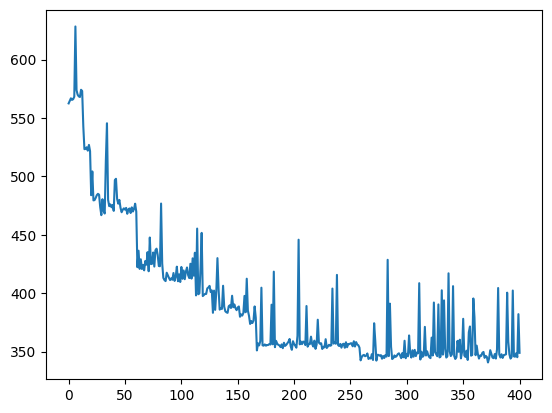

In [489]:
s = gpd.GeoSeries(map(Point, best))
plt.plot(candidate_eval_arr)

In [490]:
s.explore(m=east_king_county.explore(), color='red')

In [ ]:
best_10, best_eval_10, candidate_arr_10, candidate_eval_arr_10 = simulated_annealing(10, sample_points, income_arr, fitness_3_min, 250, 0.001, 10)
best_20, best_eval_20, candidate_arr_20, candidate_eval_arr_20 = simulated_annealing(20, sample_points, income_arr, fitness_3_min, 250, 0.001, 10)
best_30, best_eval_30, candidate_arr_30, candidate_eval_arr_30 = simulated_annealing(30, sample_points, income_arr, fitness_3_min, 250, 0.001, 10)